In [2]:
def bbox_center_normalised(dets, pil_img):

    # pick the first/only detection
    x1, y1, x2, y2 = dets.xyxy[0]             # float32 coordinates
    cx = (x1 + x2) / 2                        # center x (pixels)
    cy = (y1 + y2) / 2                        # center y (pixels)

    W, H = pil_img.size                       # (width, height) in pixels
    return cx / W, cy / H                     # normalized 0-1


In [3]:
#Tuned to 0.372 ratio in X

def up_down(y):
    bot = (1 - y)
    if bot < 0.372:
        return True
    return False
    

In [4]:
import os
from rfdetr import RFDETRBase
from PIL import Image
import supervision as sv
import time
import torch


device = "mps" if torch.backends.mps.is_available() else "cpu"
print(f"✅ Using device: {device}")

# point 'weightsjake.pt' at your locally-saved checkpoint
weights_path = os.path.expanduser("~/downloads/weightsjake.pt")

# instantiate with your custom weights
model = RFDETRBase(
  pretrain_weights=weights_path,
  num_classes=3,            # ← match your checkpoint
)

def cycle2(j,i):
    start = time.time()
    # now do your usual inference…
    image = Image.open(os.path.expanduser(f"~/SubwaySurfers/train_screenshots/frame_00{j}{i}.jpg"))
    
    # … your existing code up to detections = model.predict(…)
    detections = model.predict(image, threshold=0.3)
    if detections.xyxy.shape[0] == 0:
        print("⚠️ No detections found")
        return 

    
    cx_norm, cy_norm = bbox_center_normalised(detections, image)

    print(f"Jake center  →  x: {cx_norm:.3f},  y: {cy_norm:.3f}")
    
    # visualise (unchanged)
    annot = sv.BoxAnnotator().annotate(image.copy(), detections)
    annot = sv.LabelAnnotator().annotate(
        annot, detections,
        [f"{cid} {conf:.2f}" for cid, conf in zip(detections.class_id, detections.confidence)]
    )
    sv.plot_image(annot)

    end = time.time()
    
    print(f"Inference time: {(end - start) * 1000:.2f} ms")

    if up_down(cy_norm):
        print('Jake is on the ground')
    else:
        print('Jake is in the air')
        


✅ Using device: mps
Loading pretrain weights


 image 10
Jake center  →  x: 0.546,  y: 0.749


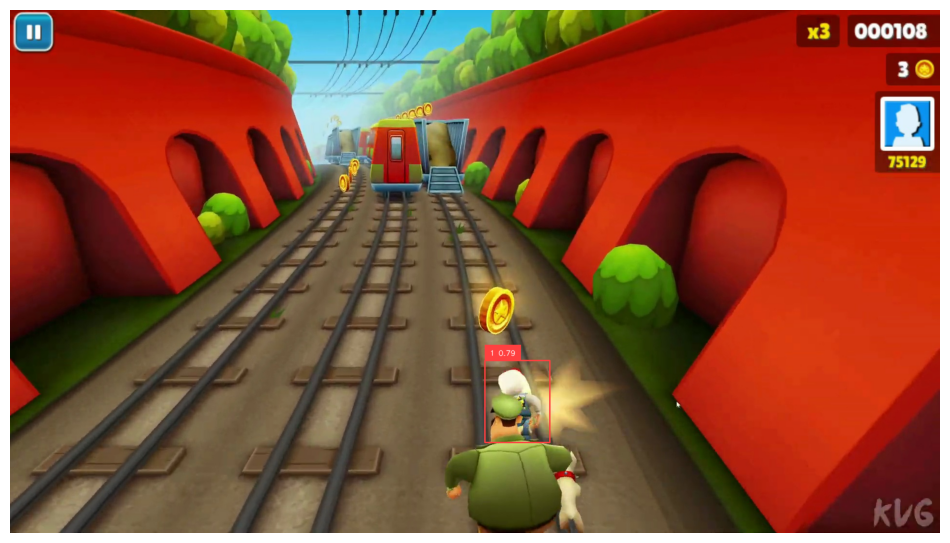

Inference time: 772.07 ms
Jake is on the ground
 image 20
Jake center  →  x: 0.556,  y: 0.765


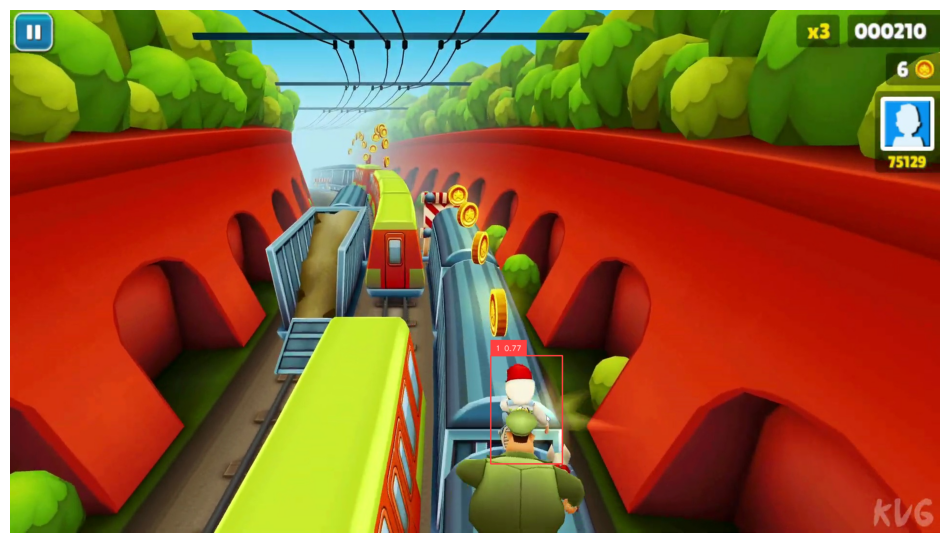

Inference time: 1388.99 ms
Jake is on the ground
 image 30
Jake center  →  x: 0.488,  y: 0.427


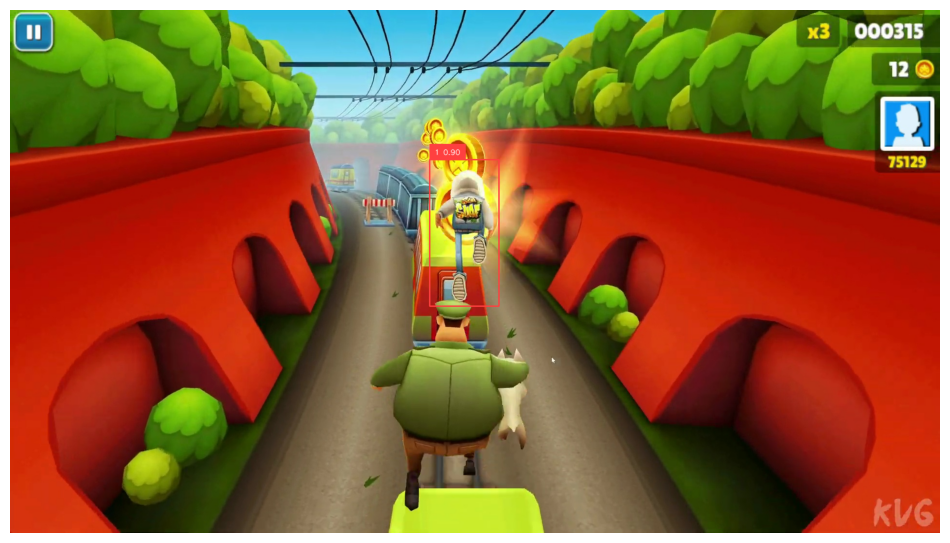

Inference time: 467.19 ms
Jake is in the air
 image 40
Jake center  →  x: 0.495,  y: 0.753


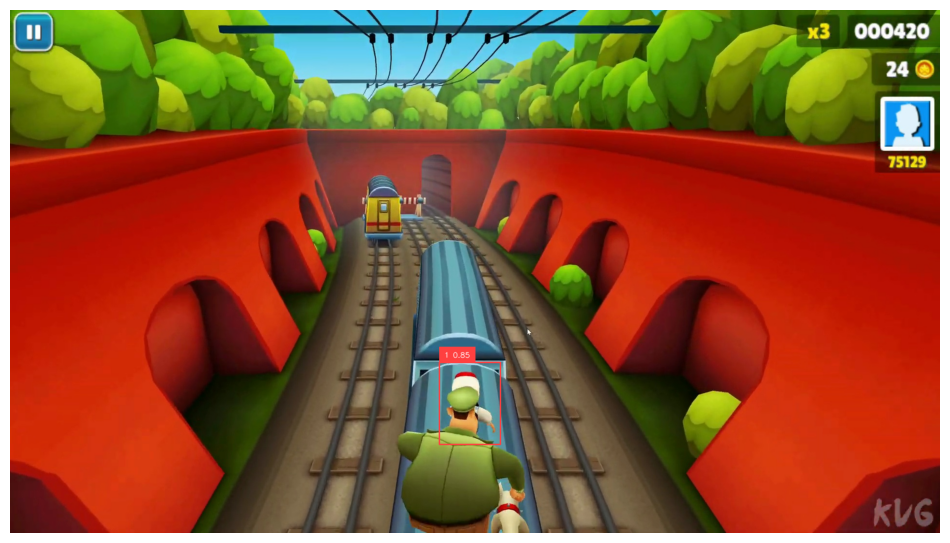

Inference time: 413.69 ms
Jake is on the ground
 image 50
Jake center  →  x: 0.561,  y: 0.669


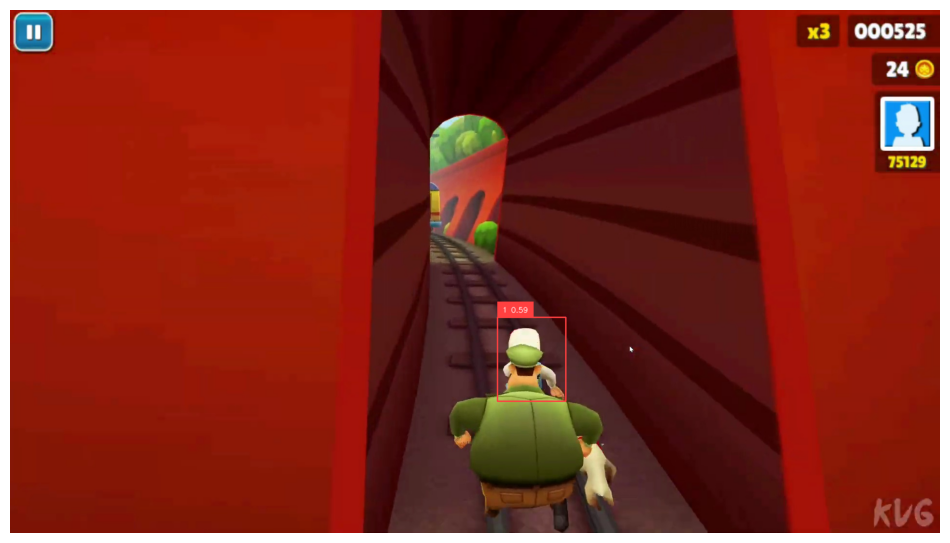

Inference time: 391.25 ms
Jake is on the ground
 image 60
Jake center  →  x: 0.481,  y: 0.792


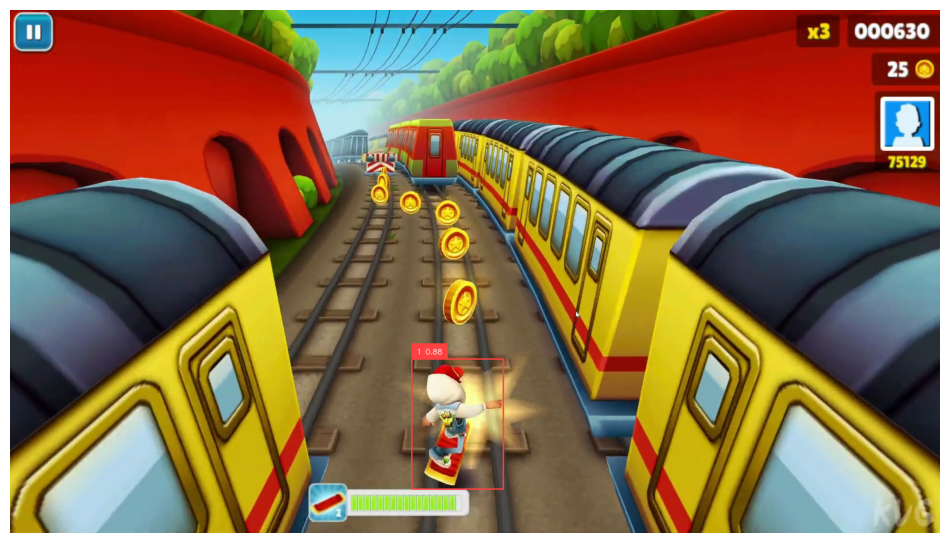

Inference time: 408.03 ms
Jake is on the ground
 image 70
Jake center  →  x: 0.442,  y: 0.802


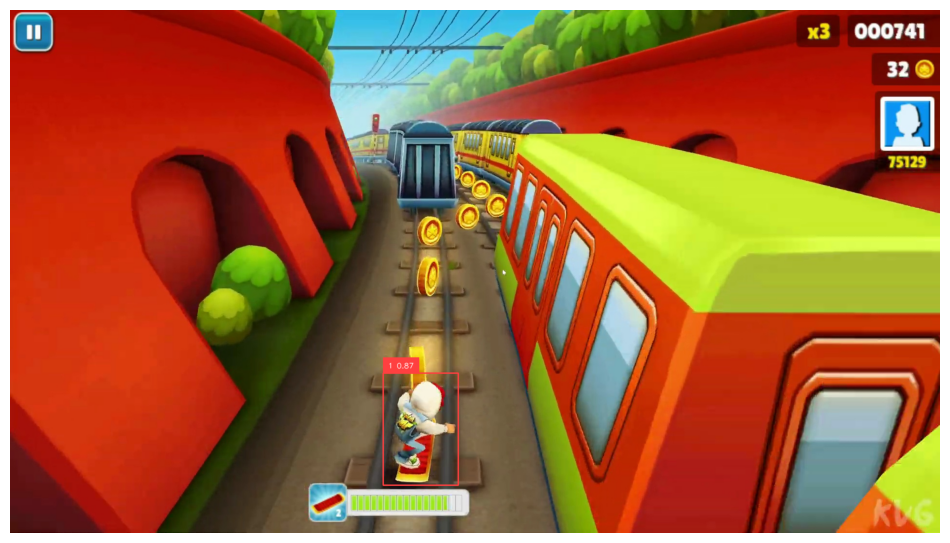

Inference time: 430.51 ms
Jake is on the ground
 image 80
Jake center  →  x: 0.506,  y: 0.800


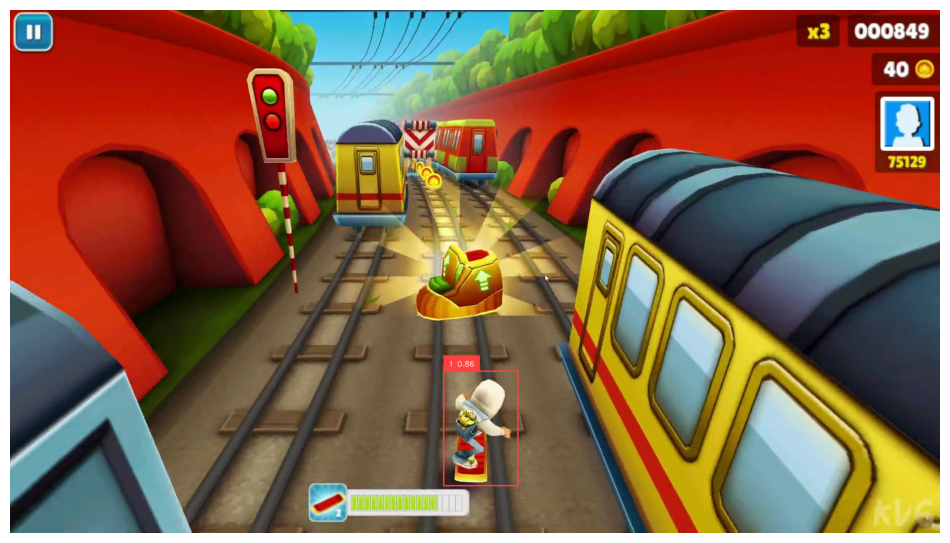

Inference time: 418.94 ms
Jake is on the ground
 image 90
Jake center  →  x: 0.514,  y: 0.794


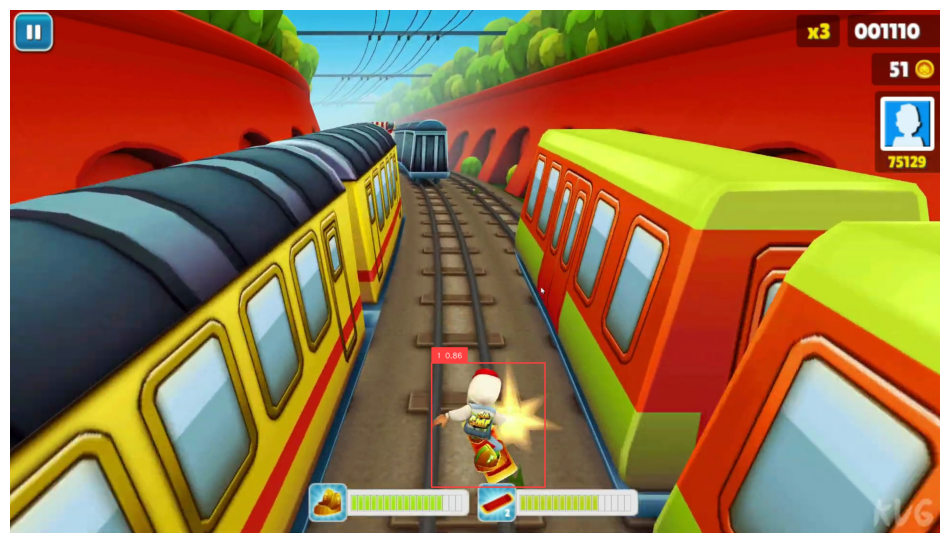

Inference time: 422.06 ms
Jake is on the ground
 image 11
Jake center  →  x: 0.504,  y: 0.641


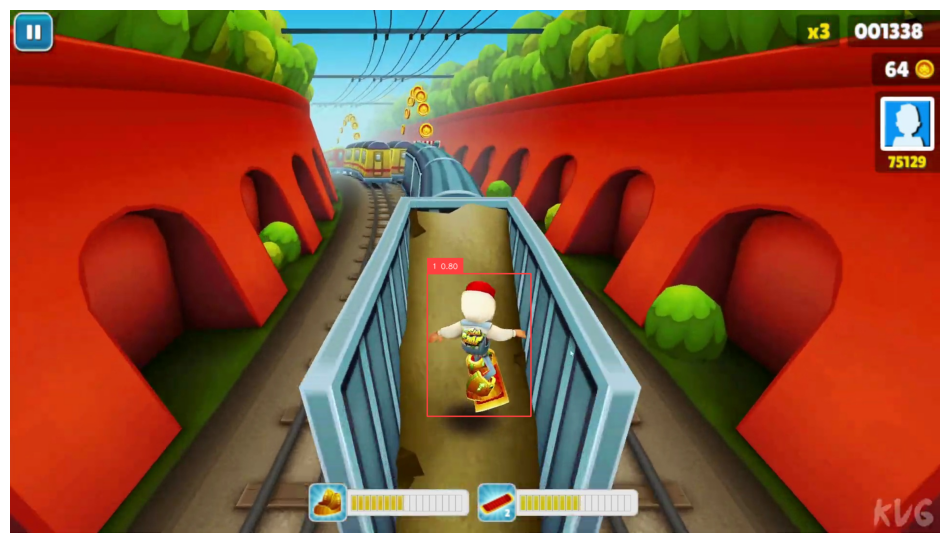

Inference time: 424.50 ms
Jake is on the ground
 image 21
Jake center  →  x: 0.411,  y: 0.496


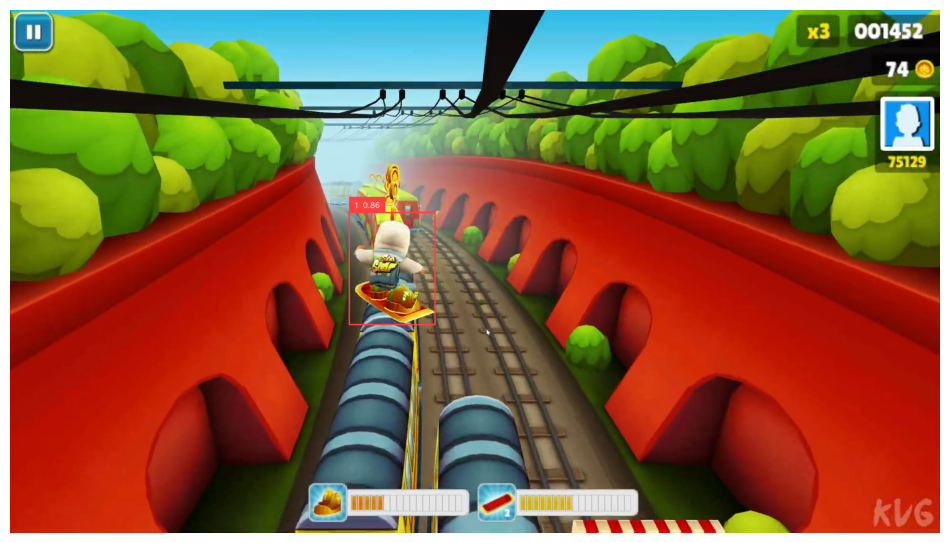

Inference time: 379.68 ms
Jake is in the air
 image 31
Jake center  →  x: 0.507,  y: 0.791


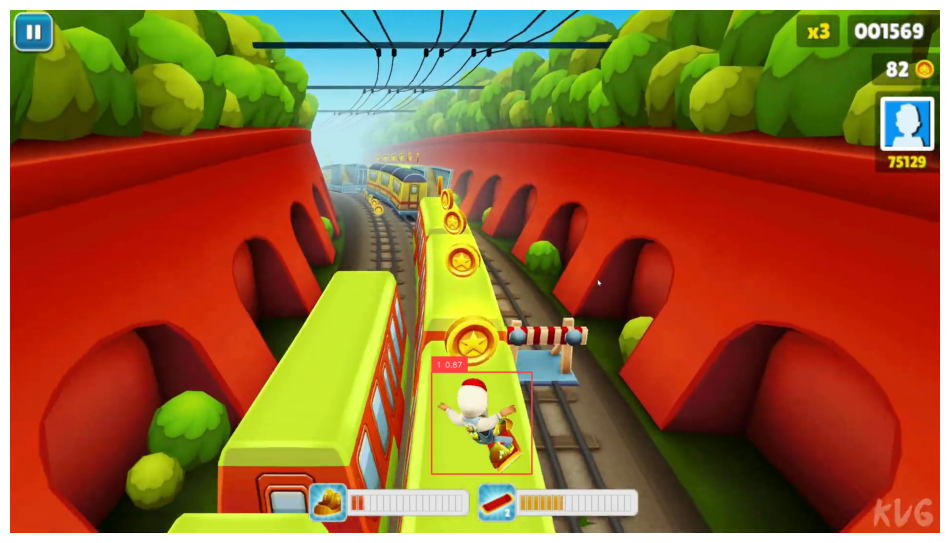

Inference time: 396.70 ms
Jake is on the ground
 image 41
Jake center  →  x: 0.562,  y: 0.673


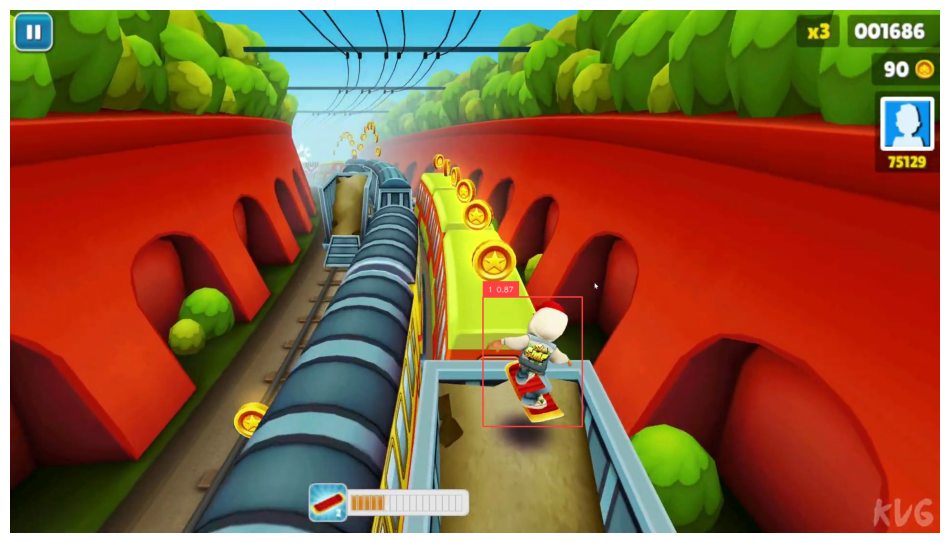

Inference time: 431.29 ms
Jake is on the ground
 image 51
Jake center  →  x: 0.496,  y: 0.575


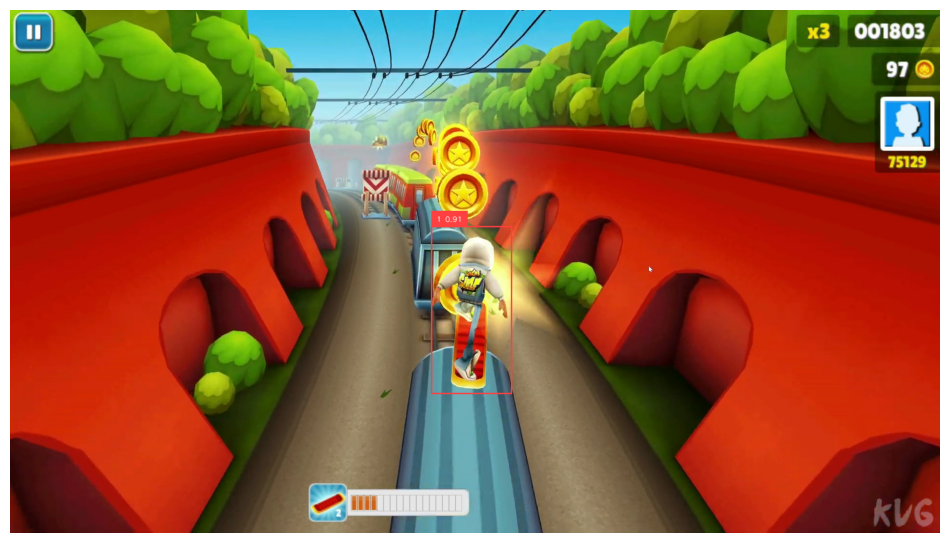

Inference time: 407.71 ms
Jake is in the air
 image 61
Jake center  →  x: 0.499,  y: 0.753


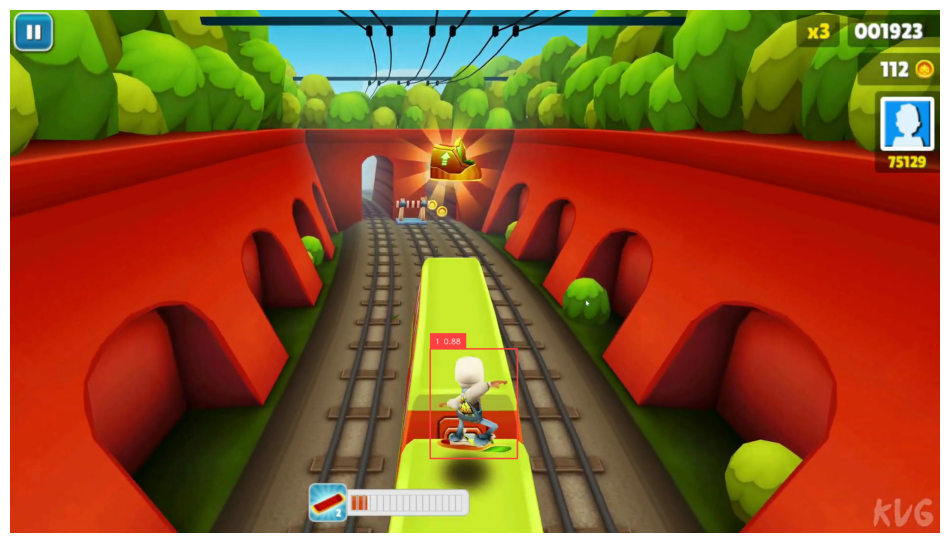

Inference time: 409.73 ms
Jake is on the ground
 image 71
Jake center  →  x: 0.547,  y: 0.575


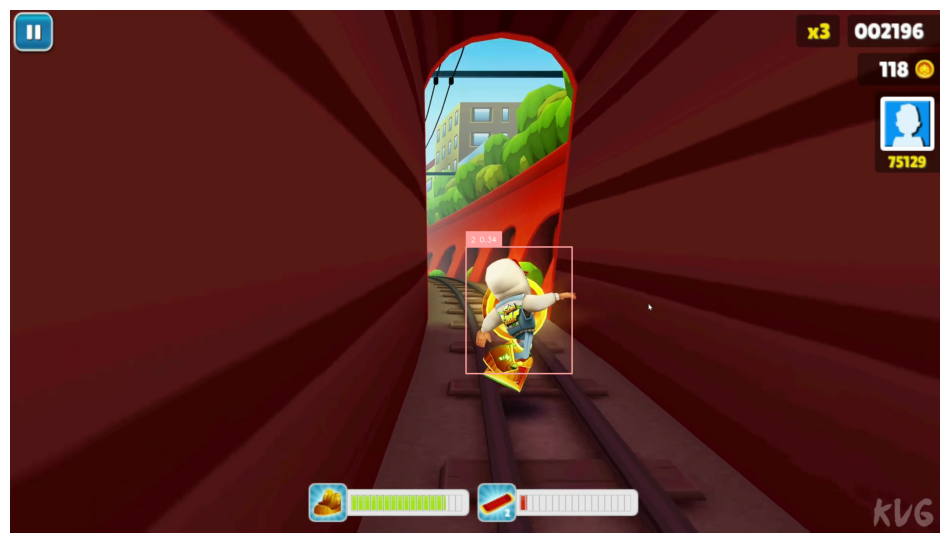

Inference time: 395.08 ms
Jake is in the air
 image 81
Jake center  →  x: 0.492,  y: 0.688


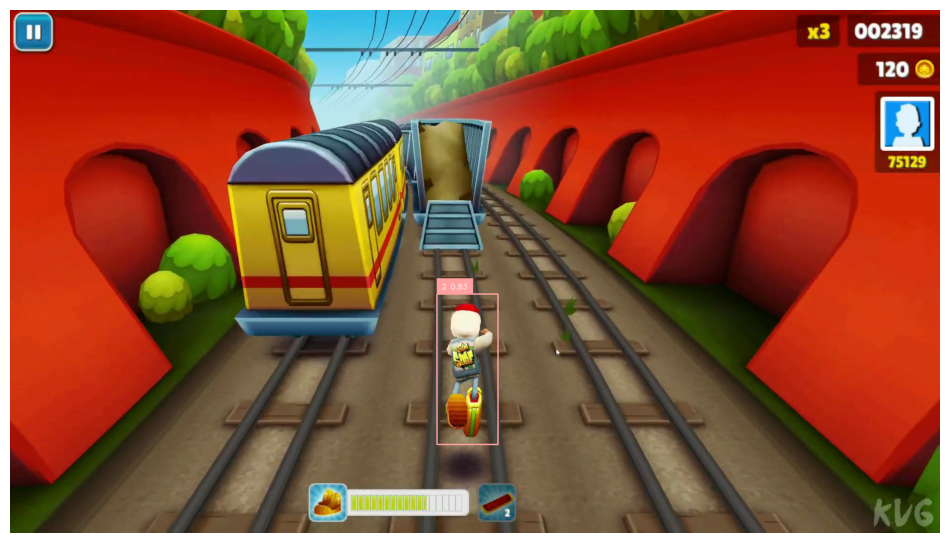

Inference time: 398.56 ms
Jake is on the ground
 image 91
Jake center  →  x: 0.433,  y: 0.784


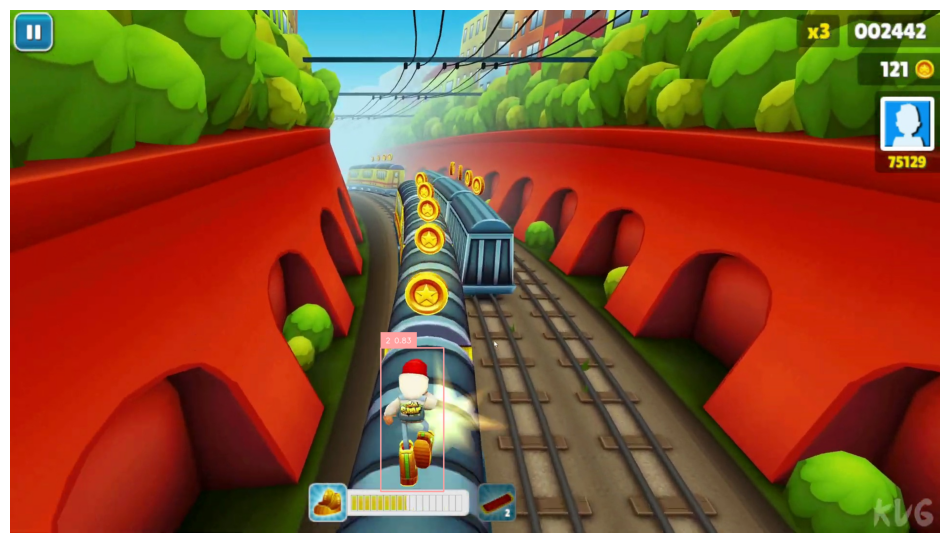

Inference time: 402.16 ms
Jake is on the ground
 image 12
Jake center  →  x: 0.492,  y: 0.545


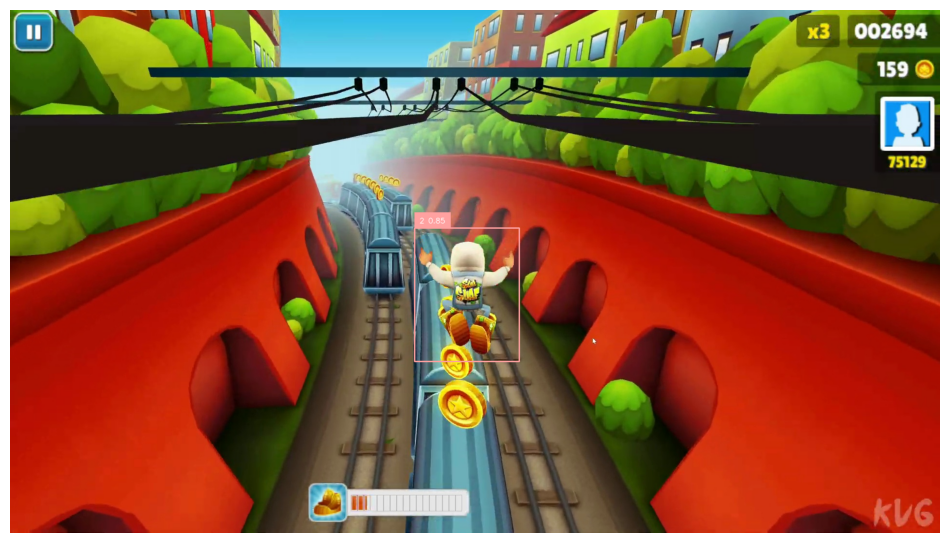

Inference time: 428.67 ms
Jake is in the air
 image 22
⚠️ No detections found
 image 32
Jake center  →  x: 0.542,  y: 0.906


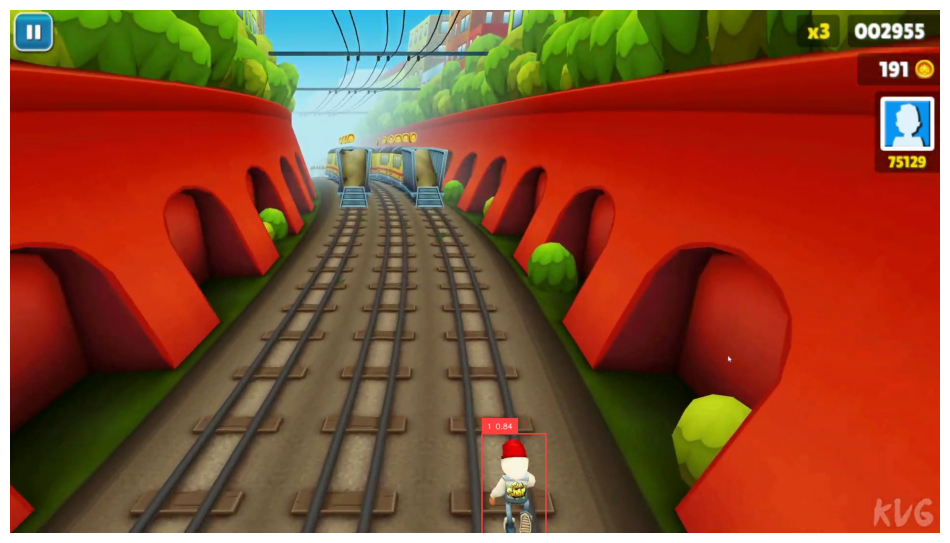

Inference time: 316.53 ms
Jake is on the ground
 image 42
Jake center  →  x: 0.556,  y: 0.774


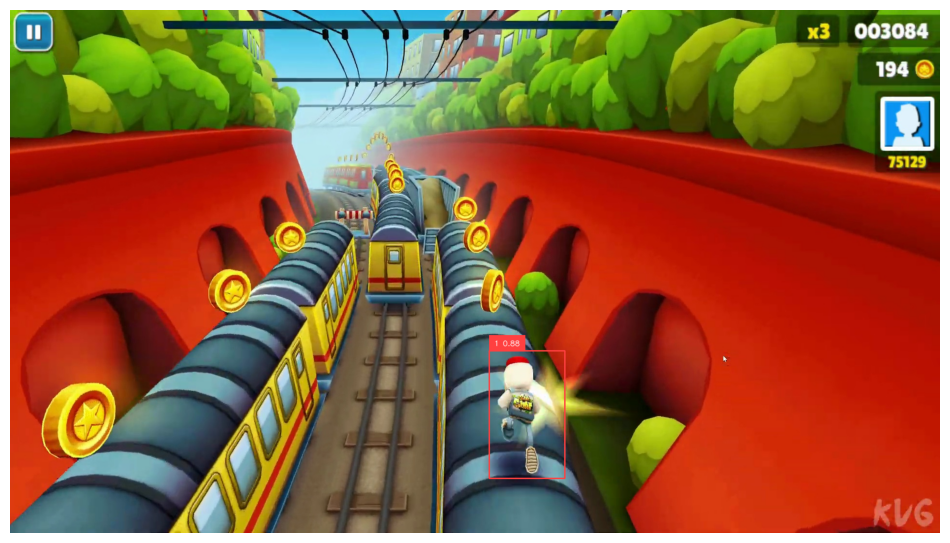

Inference time: 445.20 ms
Jake is on the ground
 image 52
Jake center  →  x: 0.550,  y: 0.803


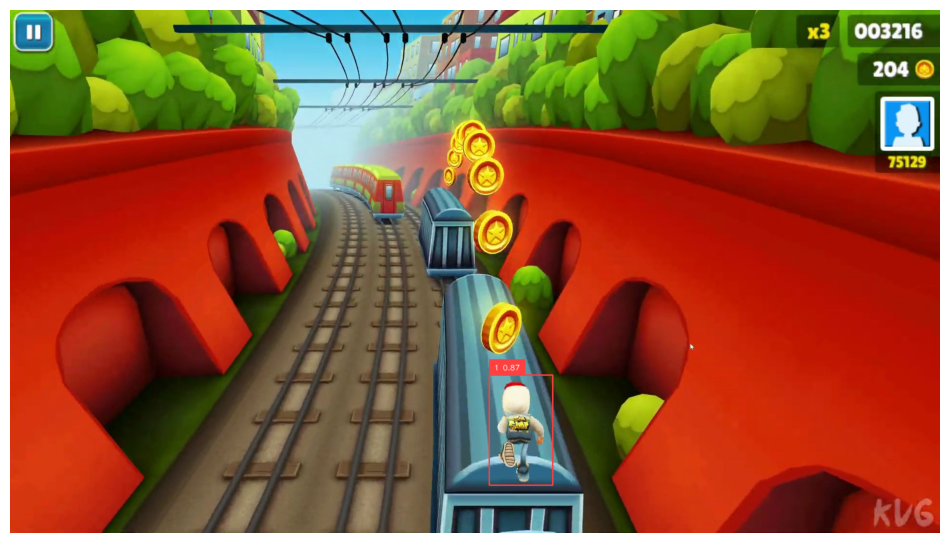

Inference time: 409.27 ms
Jake is on the ground
 image 62
Jake center  →  x: 0.410,  y: 0.836


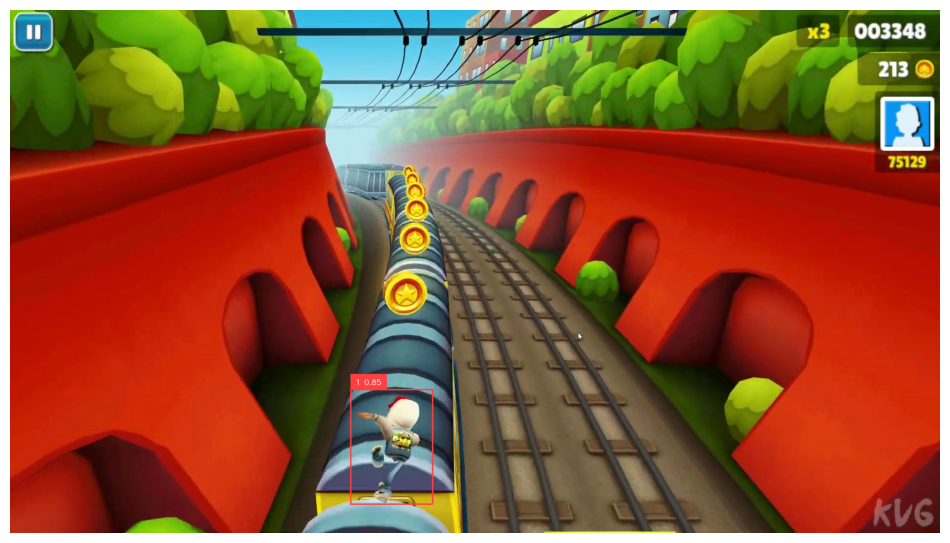

Inference time: 439.31 ms
Jake is on the ground
 image 72
Jake center  →  x: 0.494,  y: 0.791


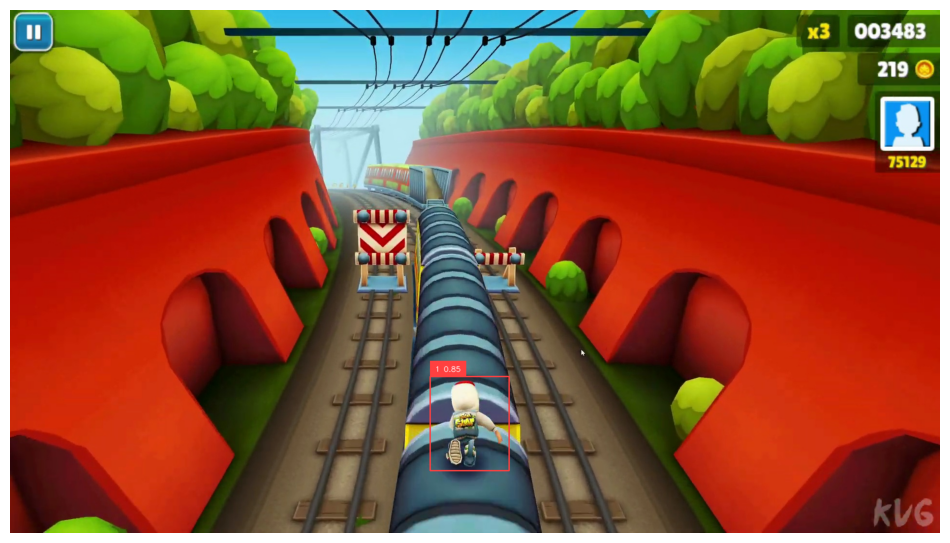

Inference time: 409.12 ms
Jake is on the ground
 image 82
Jake center  →  x: 0.491,  y: 0.797


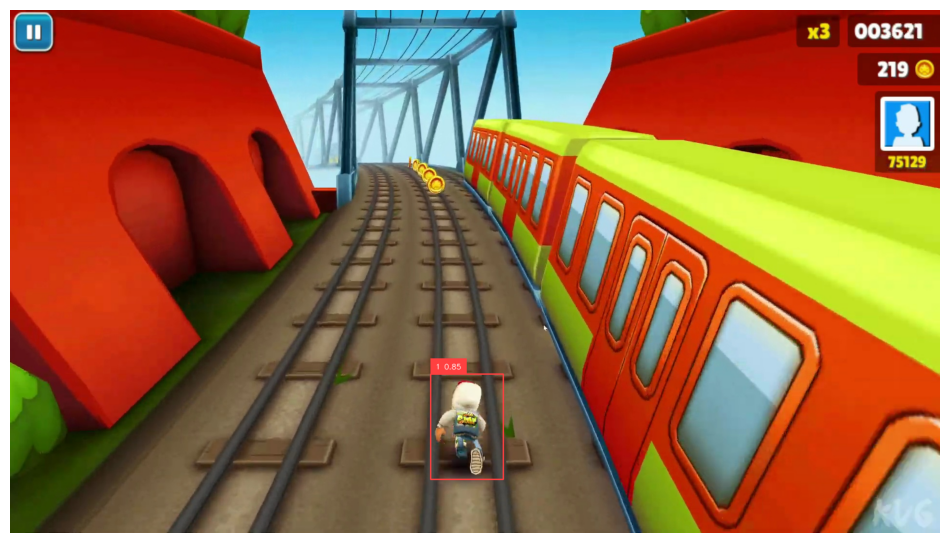

Inference time: 721.03 ms
Jake is on the ground
 image 92
Jake center  →  x: 0.546,  y: 0.789


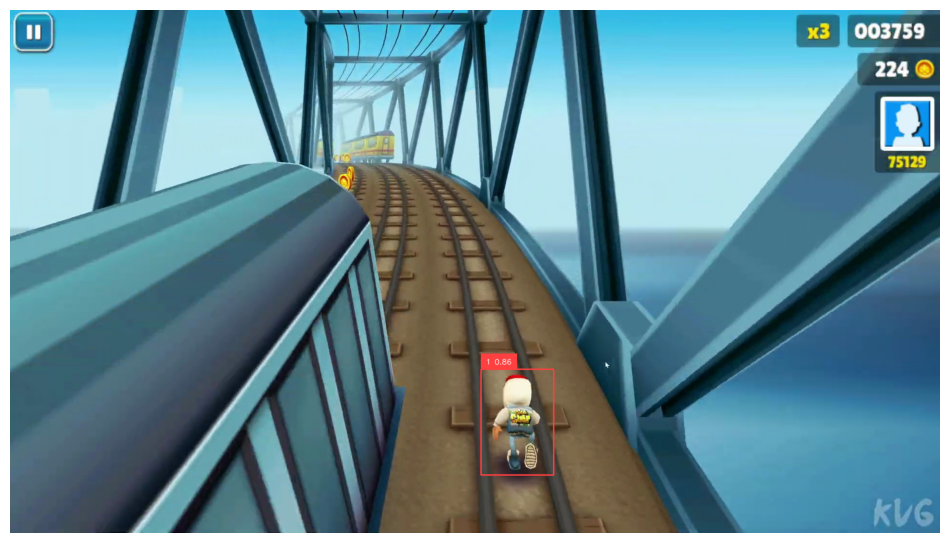

Inference time: 390.13 ms
Jake is on the ground


In [6]:
for j in range(3):
    for i in range(1,10):
        print(f' image {i}{j}')
        cycle2(j, i)
        